<img align="right" width="400" src="https://www.fhnw.ch/de/++theme++web16theme/assets/media/img/fachhochschule-nordwestschweiz-fhnw-logo.svg" alt="FHNW Logo">


# Text Normalization

by Fabian Märki

## Summary
The aim of this notebook is to show how text can be tokenized, stemmed, lemmanized in order to prepare it as training data for a downstream nlp task. Additionally, it visualizes the data in various ways in order to decide upon reasonable stopwords for the training data at hand. It then uses some simple count features to identify malformed/outlier data that should be removed from the training dataset. 

<a href="https://colab.research.google.com/github/markif/2021_HS_DAS_NLP_Notebooks/blob/master/02_b_Text_Normalization.ipynb">
  <img align="left" src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
</a>

In [2]:
!pip install 'fhnw-nlp-utils>=0.2.8,<0.3'

from fhnw.nlp.utils.processing import parallelize_dataframe
from fhnw.nlp.utils.processing import is_iterable
from fhnw.nlp.utils.storage import download
from fhnw.nlp.utils.storage import save_dataframe
from fhnw.nlp.utils.storage import load_dataframe
from fhnw.nlp.utils.text import join_tokens

import pandas as pd
import numpy as np

You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.


In [3]:
%%time
download("https://drive.google.com/uc?id=157B_040GQF3bBmla-VUzrzRfVFdkBjec", "data/german_doctor_reviews_cleaned.parq")
data = load_dataframe("data/german_doctor_reviews_cleaned.parq")
data.shape

CPU times: user 1.24 s, sys: 384 ms, total: 1.63 s
Wall time: 1.28 s


(350097, 3)

In [4]:
data.head(3)

,text_original,rating,text
0,Ich bin franzose und bin seit ein paar Wochen ...,2.0,Ich bin franzose und bin seit ein paar Wochen ...
1,Dieser Arzt ist das unmöglichste was mir in me...,6.0,Dieser Arzt ist das unmöglichste was mir in me...
2,Hatte akute Beschwerden am Rücken. Herr Magura...,1.0,Hatte akute Beschwerden am Rücken. Herr Magura...


Helper functions to do tokenization, stemming and lemmantization

In [5]:
def tokenize(text, stopwords):
    """Tokenizes a text and removes stopwords

    Parameters
    ----------
    text : str, iterable
        The text either as string or iterable of tokens (in this case tokenization is not applied)
    stopwords : set
        A set of stopword to remove from the tokens
        
    Returns
    -------
    list
        The tokenized text
    """
    from fhnw.nlp.utils.processing import is_iterable
    
    if isinstance(text, str):
        from nltk.tokenize import word_tokenize
        word_tokens = word_tokenize(text)
    elif is_iterable(text):
        word_tokens = text
    else:
        raise TypeError("Only string or iterable (e.g. list) is supported. Received a "+ str(type(text)))

    return [word.lower() for word in word_tokens if word.lower() not in stopwords]

def tokenize_stem(text, stopwords, stemmer):
    """Tokenizes and stems a text and removes stopwords

    Parameters
    ----------
    text : str, iterable
        The text either as string or iterable of tokens (in this case tokenization is not applied)
    stopwords : set
        A set of stopword to remove from the tokens
    stemmer: stemmer
        The stemmer to use (e.g. SnowballStemmer)
        
    Returns
    -------
    list
        The tokenized and stemmed text
    """
    from fhnw.nlp.utils.processing import is_iterable
        
    if isinstance(text, str):
        from nltk.tokenize import word_tokenize
        word_tokens = word_tokenize(text)
    elif is_iterable(text):
        word_tokens = text
    else:
        raise TypeError("Only string or iterable (e.g. list) is supported. Received a "+ str(type(text)))

    return [stemmer.stem(word.lower()) for word in word_tokens if word.lower() not in stopwords]

def tokenize_lemma(text, stopwords, lemmanizer, keep_ners=False):
    """Tokenizes and lemmatizes a text and removes stopwords

    Parameters
    ----------
    text : str, iterable
        The text either as string or iterable of tokens (in this case tokenization is not applied)
    stopwords : set
        A set of stopword to remove from the tokens
    lemmanizer: spacy nlp pipeline
        The lemmanizer to use (must be spacy nlp pipeline)
    keep_ner: bool
        Defines if named entities (NERs) should be keept in one token
        
    Returns
    -------
    list
        The tokenized and lemmatized text
    """
    from fhnw.nlp.utils.processing import is_iterable
        
    if isinstance(text, str):
        text = text
    elif is_iterable(text):
        from fhnw.nlp.utils.text import join_tokens
        text = join_tokens(text, set())
    else:
        raise TypeError("Only string or iterable (e.g. list) is supported. Received a "+ str(type(text)))  
    
    if keep_ners:
        # HanoverTagger could be an alternative but takes longer 
        # see: https://textmining.wp.hs-hannover.de/Preprocessing.html#Lemmatisierung-und-Wortarterkennung
        doc = lemmanizer(text, disable=['tagger', 'parser'])

        tokens = list()
        ner_idx = 0
        tok_idx = 0

        # keep ner in one token
        while tok_idx < len(doc):
            if ner_idx >= len(doc.ents) or doc[tok_idx].idx < doc.ents[ner_idx].start_char:
                if doc[tok_idx].is_alpha and not doc[tok_idx].is_punct and doc[tok_idx].text.lower() not in stopwords and doc[tok_idx].lemma_.lower() not in stopwords:
                    #print("token ", doc[tok_idx].lemma_.lower())
                    tokens.append(doc[tok_idx].lemma_.lower())

                tok_idx += 1
            else:
                #print("ner ", doc.ents[ner_idx].lemma_.lower())
                tokens.append(doc.ents[ner_idx].lemma_.lower())

                tok_idx += 1
                while tok_idx < len(doc) and doc[tok_idx].idx < doc.ents[ner_idx].end_char:
                    tok_idx += 1

                ner_idx += 1

        return tokens
    else:
        doc = lemmanizer(text, disable=['tagger', 'parser', 'ner']) 
        return [tok.lemma_.lower() for tok in doc if tok.is_alpha and not tok.is_punct and tok.text.lower() not in stopwords and tok.lemma_.lower() not in stopwords]


def normalize(text, stopwords, stemmer=None, lemmanizer=None, lemma_with_ner=False):
    """Normalizes (e.g. tokenize and stem) a text and removes stopwords

    Parameters
    ----------
    text : str, iterable
        The text either as string or iterable of tokens (in this case tokenization is not applied)
    stopwords : set
        A set of stopword to remove from the tokens
    stemmer: stemmer
        The stemmer to use (e.g. SnowballStemmer) or None to disable stemming
    lemmanizer: spacy nlp pipeline
        The lemmanizer to use (must be spacy nlp pipeline) or None to disable lemmantization
    lemma_with_ner: bool
        Defines if named entities (NERs) should be keept in one token
        
    Returns
    -------
    list
        The normalized text
    """
        
    if lemmanizer is not None:
        return tokenize_lemma(text, stopwords, lemmanizer, keep_ners=lemma_with_ner)
    elif stemmer is not None:
        return tokenize_stem(text, stopwords, stemmer)
    else:
        return tokenize(text, stopwords)

In [6]:
!pip install 'spacy>=3.0.5'
!pip install nltk
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer

import spacy
!python3 -m spacy download de_core_news_lg

nlp = spacy.load("de_core_news_lg")

import nltk
nltk.download('punkt')
nltk.download('stopwords')

stemmer = SnowballStemmer("german")
stopwords = set(stopwords.words("german"))
#stopwords = set(nlp.Defaults.stop_words)
empty_stopwords = set()

You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.
You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.
2021-11-05 05:53:33.125800: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
     |████████████████████████████████| 571.2 MB 49 kB/s  eta 0:00:01     |██████▏                         | 109.9 MB 5.7 MB/s eta 0:01:21


You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.
✔ Download and installation successful
You can now load the package via spacy.load('de_core_news_lg')


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


### Setup Sentiment

The classification should recognize if a comment has a positive or negative sentiment. Let's assume that a good rating (1-2) caries a positive message whereas a low rating (5-6) caries a negative one (later we will exclude neutral ratings, i.e. the task becomes a binary classification).

In [7]:
data["label"] = "positive"
data.loc[data["rating"] >= 3, "label"] = "neutral"
data.loc[data["rating"] >= 5, "label"] = "negative"

data["sentiment"] = data["label"].apply(lambda x: 1 if x == "positive" else (-1 if x == "negative" else 0))
data = data.astype({"sentiment": "int32"})

In [8]:
data.head(3)

,text_original,rating,text,label,sentiment
0,Ich bin franzose und bin seit ein paar Wochen ...,2.0,Ich bin franzose und bin seit ein paar Wochen ...,positive,1
1,Dieser Arzt ist das unmöglichste was mir in me...,6.0,Dieser Arzt ist das unmöglichste was mir in me...,negative,-1
2,Hatte akute Beschwerden am Rücken. Herr Magura...,1.0,Hatte akute Beschwerden am Rücken. Herr Magura...,positive,1


### Setup Stopwords

Get the (lowercased) tokens first without removing stopwords in order to come up with a *reasonable* set of stopwords.

In [9]:
%%time
data = parallelize_dataframe(data, normalize, field_read="text", field_write="token_clean", stopwords=empty_stopwords, stemmer=None, lemmanizer=None, lemma_with_ner=False)

CPU times: user 10.7 s, sys: 857 ms, total: 11.5 s
Wall time: 47.2 s


Join the lowercased tokens again since some algorithms used later need text instead of tokens

In [10]:
%%time
data = parallelize_dataframe(data, join_tokens, field_read="token_clean", field_write="text_clean", stopwords=empty_stopwords)

CPU times: user 1min 15s, sys: 2.16 s, total: 1min 17s
Wall time: 1min 19s


Define the stopwords and use n-gram counts and wordclouds to decide upon words to add to the stopwords.

In [11]:
!pip install nltk

import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')

stopwords = set(stopwords.words("german"))

You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [12]:
print(stopwords)

{'deinem', 'alles', 'solche', 'selbst', 'machen', 'der', 'sie', 'am', 'dies', 'dem', 'sind', 'anderm', 'deiner', 'du', 'will', 'doch', 'anderer', 'vom', 'jedes', 'dir', 'keiner', 'anders', 'waren', 'nun', 'anderen', 'noch', 'ich', 'manchem', 'auch', 'hatte', 'keinen', 'werde', 'desselben', 'aller', 'deines', 'so', 'eines', 'dessen', 'einige', 'bei', 'kann', 'ins', 'als', 'jeden', 'einiger', 'mancher', 'ist', 'manche', 'seinen', 'von', 'zwischen', 'euren', 'hab', 'wo', 'mir', 'meine', 'jede', 'einen', 'jenen', 'ihrer', 'ihre', 'muss', 'würden', 'keinem', 'durch', 'während', 'jener', 'einigen', 'den', 'manchen', 'warst', 'jedem', 'haben', 'oder', 'derselben', 'welcher', 'auf', 'unserem', 'unser', 'aber', 'zum', 'ihr', 'ein', 'dich', 'derselbe', 'bin', 'habe', 'war', 'wenn', 'nur', 'bis', 'würde', 'einem', 'ihrem', 'um', 'keine', 'es', 'nicht', 'dann', 'jene', 'gewesen', 'denn', 'ihren', 'da', 'ihres', 'wird', 'unseres', 'zur', 'aus', 'jeder', 'welche', 'keines', 'wollte', 'in', 'daß', 'u

In [13]:
%%time
data = parallelize_dataframe(data, normalize, field_read="token_clean", field_write="token_lemma", stopwords=stopwords, stemmer=None, lemmanizer=nlp, lemma_with_ner=False)

CPU times: user 3min 31s, sys: 22.6 s, total: 3min 54s
Wall time: 6min 24s


In [14]:
%%time
save_dataframe(data, "data/german_doctor_reviews_tokenized.parq")

CPU times: user 52.2 s, sys: 823 ms, total: 53 s
Wall time: 53 s


Let's see how frequent the words (and their n-grams) are...

In [15]:
def create_ngram_counts(df, n = 2, field_read="token_lemma"):
    """Creates the n-gram counts of a column of text tokens

    Parameters
    ----------
    df : dataframe
        The dataframe
    n : int
        The n grams to create (e.g. 2 for bi-gram)
    field_read : str
        The column name to read from (default is token_lemma)
        
    Returns
    -------
    Counter
        The n-gram counts
    """
    from collections import Counter
        
    counter = Counter()

    # see https://stackoverflow.com/a/17071908
    #_ = df[field_read].apply(lambda x: counter.update(nltk.ngrams(x, n)))
    #_ = df[field_read].apply(lambda x: counter.update([" ".join(grams) for grams in nltk.ngrams(x, n)]))
    _ = df[field_read].apply(lambda x: counter.update([" ".join(x[i:i+n]) for i in range(len(x)-n+1)]))
    
    return counter

def plot_ngram_counts(counter, n_most_common, title="Term frequencies"):
    """Plots the n-gram counts

    Parameters
    ----------
    counter : Counter
        The counter of the n-grams
    n_most_common : int
        The n most common n-grams to plog
    title : str
        The title of the plot
    """
    
    import matplotlib.pyplot as plt
        
    y = [count for tag, count in counter.most_common(n_most_common)]
    x = [tag for tag, count in counter.most_common(n_most_common)]

    plt.bar(x, y)
    plt.title(title)
    plt.ylabel("Frequency")
    #plt.yscale('log') # set log scale for y-axis
    plt.xticks(rotation=90)
    for i, (tag, count) in enumerate(counter.most_common(n_most_common)):
        plt.text(i, count, f' {count} ', rotation=90, ha='center', va='top' if i < 10 else 'bottom', color='white' if i < 10 else 'black')
    plt.xlim(-0.6, len(x)-0.4) # set tighter x lims
    plt.tight_layout() # change the whitespace such that all labels fit nicely
    plt.show()

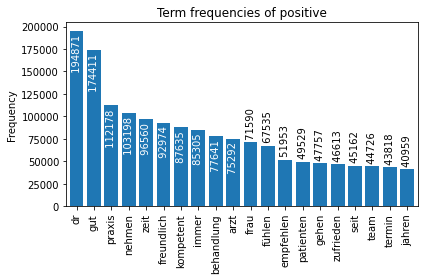

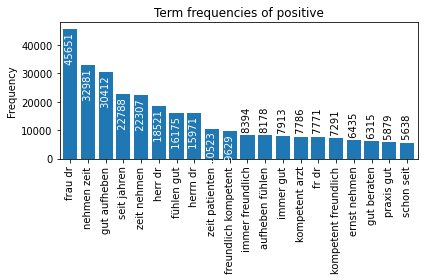

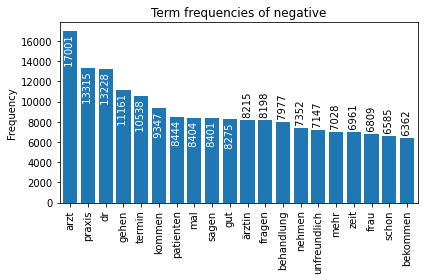

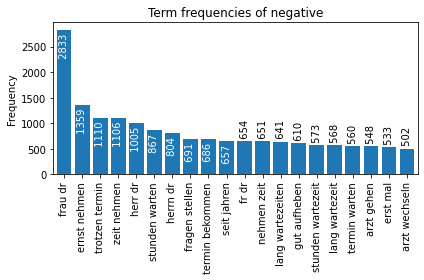

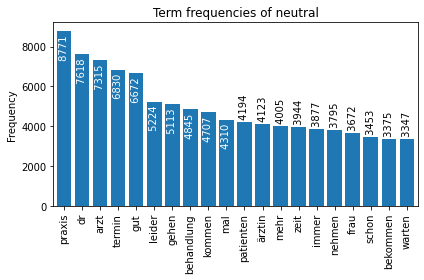

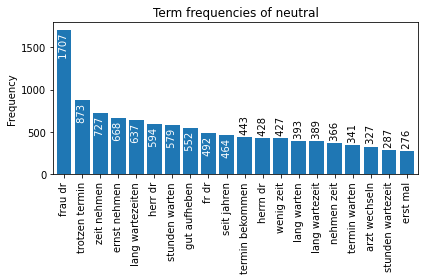

In [16]:
for label in data["label"].unique():
    ngrams_1 = create_ngram_counts(data.loc[(data["label"] == label)], 1)
    ngrams_2 = create_ngram_counts(data.loc[(data["label"] == label)], 2)
    
    plot_ngram_counts(ngrams_1, 20, "Term frequencies of "+label)
    plot_ngram_counts(ngrams_2, 20, "Term frequencies of "+label)

In [17]:
stopwords.add("frau")
stopwords.add("dr")
stopwords.add("herr")
stopwords.add("herrn")
stopwords.add("fr")
stopwords.add("werden")

stopwords.remove("nicht")

In [18]:
!pip install wordcloud

def create_word_cloud(df, label, field="token_lemma"):
    """Creates a wordcloud of a column of text

    Parameters
    ----------
    df : dataframe
        The dataframe
    field : str
        The column name to read from (default is token_lemma)
    """
        
    import matplotlib.pyplot as plt
    from collections import Counter
    from wordcloud import WordCloud
    
    counter = Counter()
    # see https://stackoverflow.com/a/17071908
    _ = df["token_lemma"].apply(counter.update)
    
    print(label, "- with", len(counter.keys()), "number of words.")

    wc = WordCloud(background_color="white", max_words=1000)
    wc.generate_from_frequencies(counter)

    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.


positive - with 142713 number of words.


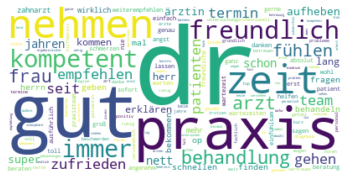

negative - with 60782 number of words.


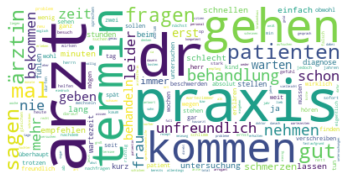

neutral - with 42342 number of words.


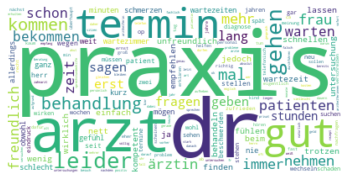

In [19]:
for label in data["label"].unique():
    create_word_cloud(data.loc[(data["label"] == label)], label, field="token_lemma")

Recreate the colums with the extended stopwords 

In [20]:
%%time
data = data.drop(columns=["token_lemma"], errors='ignore')
data = parallelize_dataframe(data, normalize, field_read="token_clean", field_write="token_lemma", stopwords=stopwords, stemmer=None, lemmanizer=nlp, lemma_with_ner=False)

CPU times: user 3min 27s, sys: 19.7 s, total: 3min 46s
Wall time: 6min 14s


In [21]:
%%time
data = parallelize_dataframe(data, normalize, field_read="token_clean", field_write="token_stem", stopwords=stopwords, stemmer=stemmer, lemmanizer=None, lemma_with_ner=False)

CPU times: user 1min 19s, sys: 3.53 s, total: 1min 22s
Wall time: 1min 33s


In [22]:
%%time
data = parallelize_dataframe(data, normalize, field_read="token_clean", field_write="token_clean_stopwords", stopwords=stopwords, stemmer=None, lemmanizer=None, lemma_with_ner=False)

CPU times: user 1min 19s, sys: 3.8 s, total: 1min 23s
Wall time: 1min 28s


In [23]:
data.head(3)

,text_original,rating,text,label,sentiment,token_clean,text_clean,token_lemma,token_stem,token_clean_stopwords
0,Ich bin franzose und bin seit ein paar Wochen ...,2.0,Ich bin franzose und bin seit ein paar Wochen ...,positive,1,"[ich, bin, franzose, und, bin, seit, ein, paar...",ich bin franzose und bin seit ein paar wochen ...,"[franzose, seit, paar, wochen, muenchen, zahn,...","[franzos, seit, paar, woch, muench, ., zahn, s...","[franzose, seit, paar, wochen, muenchen, ., za..."
1,Dieser Arzt ist das unmöglichste was mir in me...,6.0,Dieser Arzt ist das unmöglichste was mir in me...,negative,-1,"[dieser, arzt, ist, das, unmöglichste, was, mi...",dieser arzt ist das unmöglichste was mir in me...,"[arzt, unmöglichste, leben, je, begegnen, unfr...","[arzt, unmog, leb, je, begegnet, unfreund, ,, ...","[arzt, unmöglichste, leben, je, begegnet, unfr..."
2,Hatte akute Beschwerden am Rücken. Herr Magura...,1.0,Hatte akute Beschwerden am Rücken. Herr Magura...,positive,1,"[hatte, akute, beschwerden, am, rücken, ., her...",hatte akute beschwerden am rücken . herr magur...,"[akut, beschwerden, rücken, magura, erste, arz...","[akut, beschwerd, ruck, ., magura, erst, arzt,...","[akute, beschwerden, rücken, ., magura, erste,..."


In [24]:
%%time
save_dataframe(data, "data/german_doctor_reviews_tokenized.parq")

CPU times: user 1min 7s, sys: 868 ms, total: 1min 8s
Wall time: 1min 8s


Let's extract some simple features to see if there are *outlier* (i.e. *strange*) reviews. 

In [25]:
def char_count(text):
    """Counts the characters of a text

    Parameters
    ----------
    text : str, iterable
        The text either as string or iterable of tokens
        
    Returns
    -------
    int
        The character count
    """
    from fhnw.nlp.utils.processing import is_iterable
        
    if isinstance(text, str):
        text = text
    elif is_iterable(text):
        from fhnw.nlp.utils.text import join_tokens
        text = join_tokens(text)
    else:
        raise TypeError("Only string or list is supported. Received a "+ str(type(text))) 
        
    return len(text)

def word_count(text):
    """Counts the words of a text

    Parameters
    ----------
    text : str, iterable
        The text either as string or iterable of tokens
        
    Returns
    -------
    int
        The word count
    """
    from fhnw.nlp.utils.processing import is_iterable
        
    if isinstance(text, str):
        from nltk.tokenize import word_tokenize
        tokens = word_tokenize(text)
    elif is_iterable(text):
        tokens = text
    else:
        raise TypeError("Only string or list is supported. Received a "+ str(type(text))) 
    
    return len(tokens)

def unique_words(text):
    """Counts the unique words of a text

    Parameters
    ----------
    text : str, iterable
        The text either as string or iterable of tokens
        
    Returns
    -------
    int
        The unique word count
    """
    from fhnw.nlp.utils.processing import is_iterable
        
    if isinstance(text, str):
        from nltk.tokenize import word_tokenize
        tokens = word_tokenize(text)
    elif is_iterable(text):
        tokens = text
    else:
        raise TypeError("Only string or list is supported. Received a "+ str(type(text)))
    
    unique_words = set(tokens)
    return len(unique_words)

In [26]:
%%time
data = parallelize_dataframe(data, char_count, field_read="token_lemma", field_write="char_count")
data = parallelize_dataframe(data, word_count, field_read="token_lemma", field_write="word_count")
data = parallelize_dataframe(data, unique_words, field_read="token_lemma", field_write="unique_words")

CPU times: user 1min 45s, sys: 7.83 s, total: 1min 53s
Wall time: 1min 56s


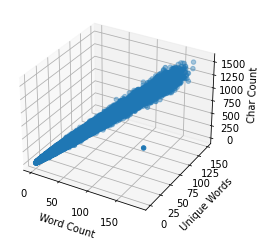

In [27]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(data["word_count"], data["unique_words"], data["char_count"])
# ax.scatter(data["word_count"], data["unique_words"], data["char_count"], s=data["char_count"])
ax.set_xlabel('Word Count')
ax.set_ylabel('Unique Words')
ax.set_zlabel('Char Count')

plt.show()

In [28]:
!pip install plotly

You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.


In [29]:
import plotly
import plotly.express as px

fig = px.scatter_3d(data, x='word_count', y='unique_words', z='char_count', size_max=18, opacity=0.7) #color='cluster', size='char_count',

# tight layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))

Try to identify outliers (by applying some filters) and remove them (if appropriate).

In [30]:
#pd.options.display.max_rows = None
#data.loc[data["word_count"] > 170]
data.query('(word_count < 1 and unique_words < 1)')

,text_original,rating,text,label,sentiment,token_clean,text_clean,token_lemma,token_stem,token_clean_stopwords,char_count,word_count,unique_words
27685,weiter so,1.0,weiter so,positive,1,"[weiter, so]",weiter so,[],[],[],0,0,0
30426,Alles so wie es sein soll!,1.0,Alles so wie es sein soll!,positive,1,"[alles, so, wie, es, sein, soll, !]",alles so wie es sein soll !,[],[!],[!],0,0,0
31887,Aber das war es auch...,5.0,Aber das war es auch...,negative,-1,"[aber, das, war, es, auch, ...]",aber das war es auch ...,[],[...],[...],0,0,0
42173,Machen Sie weiter so!,1.0,Machen Sie weiter so!,positive,1,"[machen, sie, weiter, so, !]",machen sie weiter so !,[],[!],[!],0,0,0
81555,kann´s!,1.0,kann !,positive,1,"[kann, !]",kann !,[],[!],[!],0,0,0
161601,weiter so!,1.0,weiter so!,positive,1,"[weiter, so, !]",weiter so !,[],[!],[!],0,0,0
294667,ich würde es wieder dort machen,1.0,ich würde es wieder dort machen,positive,1,"[ich, würde, es, wieder, dort, machen]",ich würde es wieder dort machen,[],[],[],0,0,0
319012,So wie es sein soll,1.0,So wie es sein soll,positive,1,"[so, wie, es, sein, soll]",so wie es sein soll,[],[],[],0,0,0


In [31]:
data = data.query('~(word_count < 1 and unique_words < 1)')

In [32]:
data.query('word_count > 20 and unique_words < 5 or word_count > 110 and unique_words < 45')

,text_original,rating,text,label,sentiment,token_clean,text_clean,token_lemma,token_stem,token_clean_stopwords,char_count,word_count,unique_words
92350,Top Top Top Top Top Top Top TopTop Top Top Top...,1.0,Top Top Top Top Top Top Top TopTop Top Top Top...,positive,1,"[top, top, top, top, top, top, top, toptop, to...",top top top top top top top toptop top top top...,"[top, top, top, top, top, top, top, toptop, to...","[top, top, top, top, top, top, top, toptop, to...","[top, top, top, top, top, top, top, toptop, to...",916,185,2
127512,sehr gut sehr gutsehr gutsehr gutsehr gutsehr ...,1.0,sehr gut sehr gutsehr gutsehr gutsehr gutsehr ...,positive,1,"[sehr, gut, sehr, gutsehr, gutsehr, gutsehr, g...",sehr gut sehr gutsehr gutsehr gutsehr gutsehr ...,"[gut, gutsehr, gutsehr, gutsehr, gutsehr, guts...","[gut, gutsehr, gutsehr, gutsehr, gutsehr, guts...","[gut, gutsehr, gutsehr, gutsehr, gutsehr, guts...",183,24,2


In [33]:
data = data.query('~(word_count > 20 and unique_words < 5 or word_count > 110 and unique_words < 45)')

In [34]:
data = data.drop(columns=["char_count", "word_count", "unique_words"], errors='ignore')

In [35]:
%%time
save_dataframe(data, "data/german_doctor_reviews_tokenized.parq")

CPU times: user 1min 5s, sys: 739 ms, total: 1min 6s
Wall time: 1min 6s
